
## 1. Coleta de Dados

In [1]:
#Importando os pacotes

import requests                    #pede o código fonte para o servidor
from bs4 import BeautifulSoup      #ajuda a modificar e interpretar o html
import time                        #pra fazer o python não derrubar o site 
import json                        #para manipular os jsons que tem no html
import pandas as pd                #pra transformar jsons e bases de dados
from datetime import date          #para pegar a data do dia
import os                          #para colocar o diretório
import numpy as np

#Mundando o diretório:

os.chdir("C:/Users/ferna/Desktop/Documentos/Pos-Graduacao/Programação/Trabalho")

#Esse requests serve pra ter sempre o mesmo resultado enquanto o código tiver ativo:

s = requests.Session()

#Utilizando uma requisição get para a página de vagas de deficiente do site:

primeira = s.get("https://www.deficienteonline.com.br/vagas-para-pcd")
primeira_soup = BeautifulSoup(primeira.text, 'lxml')
data = json.loads(primeira_soup.find_all("vagas-template")[0][':data-props'])
num_paginas = data['vagas']['last_page']
num_vagas = data['vagas']['total']

applink = "https://www.deficienteonline.com.br/vagas-para-pcd?page="
listurl = []
for i in range(1,num_paginas+1):
    listurl.append(applink+str(i))

df = pd.DataFrame()
rodada = 1
while num_vagas != len(df):
    dados = []
    print("Iniciando a rodada de coleta nº ", str(rodada),".", sep="")
    for link in listurl: #o loop pega cada link gerado no código acima e passa para o requests
        soup = BeautifulSoup(s.get(link).text , "lxml")
        obj = soup.find("vagas-template")
        suporte=json.loads(obj.attrs[':data-props'])
        dados.append(suporte)
        time.sleep(0.4)
        print(link)

    dados_final = []
    for dado in dados:
        content = dado['vagas']['data']
        tam_content = len(content)
        for i in range(0,tam_content-1):
            dados_final.append(content[str(i)])
    #
    df_aux = pd.DataFrame(dados_final)
    df_aux = df_aux.drop_duplicates()
    df = df.append(df_aux)
    df = df.drop_duplicates()
    print("A rodada nº ", str(rodada)," coletou ", len(df) , " oportunidades.", sep="")
    rodada += 1


#Inserindo a data da coleta:
today = date.today()
d1 = today.strftime("%d/%m/%Y")
d1
df.insert(0,"data", d1)

Iniciando a rodada de coleta nº 1.
https://www.deficienteonline.com.br/vagas-para-pcd?page=1
https://www.deficienteonline.com.br/vagas-para-pcd?page=2
https://www.deficienteonline.com.br/vagas-para-pcd?page=3
https://www.deficienteonline.com.br/vagas-para-pcd?page=4
https://www.deficienteonline.com.br/vagas-para-pcd?page=5
https://www.deficienteonline.com.br/vagas-para-pcd?page=6
https://www.deficienteonline.com.br/vagas-para-pcd?page=7
https://www.deficienteonline.com.br/vagas-para-pcd?page=8
https://www.deficienteonline.com.br/vagas-para-pcd?page=9
https://www.deficienteonline.com.br/vagas-para-pcd?page=10
https://www.deficienteonline.com.br/vagas-para-pcd?page=11
https://www.deficienteonline.com.br/vagas-para-pcd?page=12
https://www.deficienteonline.com.br/vagas-para-pcd?page=13
https://www.deficienteonline.com.br/vagas-para-pcd?page=14
https://www.deficienteonline.com.br/vagas-para-pcd?page=15
https://www.deficienteonline.com.br/vagas-para-pcd?page=16
https://www.deficienteonline.c

https://www.deficienteonline.com.br/vagas-para-pcd?page=23
https://www.deficienteonline.com.br/vagas-para-pcd?page=24
https://www.deficienteonline.com.br/vagas-para-pcd?page=25
https://www.deficienteonline.com.br/vagas-para-pcd?page=26
https://www.deficienteonline.com.br/vagas-para-pcd?page=27
https://www.deficienteonline.com.br/vagas-para-pcd?page=28
A rodada nº 5 coletou 305 oportunidades.
Iniciando a rodada de coleta nº 6.
https://www.deficienteonline.com.br/vagas-para-pcd?page=1
https://www.deficienteonline.com.br/vagas-para-pcd?page=2
https://www.deficienteonline.com.br/vagas-para-pcd?page=3
https://www.deficienteonline.com.br/vagas-para-pcd?page=4
https://www.deficienteonline.com.br/vagas-para-pcd?page=5
https://www.deficienteonline.com.br/vagas-para-pcd?page=6
https://www.deficienteonline.com.br/vagas-para-pcd?page=7
https://www.deficienteonline.com.br/vagas-para-pcd?page=8
https://www.deficienteonline.com.br/vagas-para-pcd?page=9
https://www.deficienteonline.com.br/vagas-para-p

In [2]:
#Visualizando a base de dados formada por todas as vagas no geral, sendo a última variável dando a url de cada vaga individual:
df

,data,id_tc_vagas,id_tc_status_vaga,is_confidencial,is_nom_empresa,nom_empresa,id_empresa,logo_caminho,logo_link_img_error,den_titulo,...,is_exibir_faixa_salarial,valor_mes,cidade,prefixo,cod_vinculo,salario_inicial,salario_final,salario_fixo,favorita,vaga_url
0,07/04/2021,25035,1,False,True,GMS Management Solutions Consultoria Brasil Ltda,2303,http://www.serpne.com.br/,False,Consultor de Negócios PCD,...,True,,Sao paulo,Sp,Contrato CLT,"R$ 3.000,00","R$ 3.000,00",None,False,consultor-de-negocios-pcd-em-sao-paulo-sp/25035
1,07/04/2021,24383,1,False,True,Poupacred,1817,http://www.serpne.com.br/i/empresas/1622_logom...,False,Vendedor de Consignado PCD,...,True,,Curitiba,Pr,Contrato CLT,"R$ 1.000,00","R$ 1.800,00",None,False,vendedor-de-consignado-pcd-em-curitiba-pr/24383
2,07/04/2021,25038,1,False,True,Risotolândia,2193,http://www.serpne.com.br/i/empresas/1999_logom...,False,Auxiliar Administrativo PCD,...,True,,Curitiba,Pr,Contrato CLT,"R$ 1.000,00","R$ 1.300,00",None,False,auxiliar-administrativo-pcd-em-curitiba-pr/25038
3,07/04/2021,24345,1,False,True,Poupacred,1817,http://www.serpne.com.br/i/empresas/1622_logom...,False,Vendedor de Consignado PCD,...,True,,Jundiai,Sp,Contrato CLT,"R$ 1.000,00","R$ 1.800,00",None,False,vendedor-de-consignado-pcd-em-jundiai-sp/24345
4,07/04/2021,16674,1,False,True,Smartfit Escola de Ginastica e Danca S.A,1286,http://www.serpne.com.br/i/empresas/1164_logom...,False,Recepcionista PCD,...,True,,Sorocaba,Sp,Contrato CLT,"R$ 1.000,00","R$ 1.300,00",None,False,recepcionista-pcd-em-sorocaba-sp/16674
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
176,07/04/2021,24283,1,False,True,Poupacred,1817,http://www.serpne.com.br/i/empresas/1622_logom...,False,Consultor de vendas PCD,...,True,,Sao roque,Sp,Contrato CLT,"R$ 1.000,00","R$ 1.800,00",None,False,consultor-de-vendas-pcd-em-sao-roque-sp/24283
212,07/04/2021,16753,1,False,True,Smartfit Escola de Ginastica e Danca S.A,1286,http://www.serpne.com.br/i/empresas/1164_logom...,False,Recepcionista PCD,...,True,,Sao bernardo do campo,Sp,Contrato CLT,"R$ 1.000,00","R$ 1.300,00",None,False,recepcionista-pcd-em-sao-bernardo-do-campo-sp/...
244,07/04/2021,24377,1,False,True,Poupacred,1817,http://www.serpne.com.br/i/empresas/1622_logom...,False,Vendedor de Consignado PCD,...,True,,Marilia,Sp,Contrato CLT,"R$ 1.000,00","R$ 1.800,00",None,False,vendedor-de-consignado-pcd-em-marilia-sp/24377
55,07/04/2021,24988,1,False,True,SERPCD - Inclusão Social,832,http://www.serpne.com.br/i/empresas/714_logoma...,False,Banco de Talentos PCD,...,True,,Florianopolis,Sc,Contrato CLT,None,None,None,False,banco-de-talentos-pcd-em-florianopolis-sc/24988


In [3]:
#Coletando as vagas individualmente
#Lendo a base arquivada:
ln = pd.read_pickle("vagaspcd.pkl")
#Pegando a base que acabamos de coletar (os dados primários), ordenando pelo id das vagas;
#Resetando o index, vai criar uma coluna indo de 1 até ..., e ai excluí a coluna de index (que seria a que estava
#antes do lado do esquerdo do id_tc_vagas)
df = df.sort_values("id_tc_vagas").reset_index().drop(columns = "index")
#Fazendo a mesma coisa acima só que para a base antiga:
df_old = ln.sort_values("id_tc_vagas").reset_index().drop(columns = "index")
#Juntando as duas bases:
concat = pd.concat([df, df_old])
#Com certeza, vão ter coisas que estão tanto na df quanto na df_old, tem células duplicadas;
#Então dropamos as duplicadas com base no id_tc_vagas;
#Além disso, estamos interessados somente nas vagas novas geradas pelo site em cada dia;
#Então usamos keep = False para dropar ambas observações duplicadas, não somente uma delas;
#Para gerarmos uma base só de informações novas:
unicos = concat.drop_duplicates(subset = "id_tc_vagas", keep = False)
#Mas podem existir vagas que estavam na df_old, mas que alguém foi empregado, e daí não entraram na base que foi 
#coletada no dia seguinte;
#Então vamos concatenar o unicos (que não está na intersecção entre df e df_old) com o df_old e com o df_old
#Para conseguirmos pegar somente os novos, quando formos usar o comando de dropar duplicadas, sendo que as duplicadas 
#podem ser mais de duas:
concatunicos = pd.concat([unicos, df_old, df_old])
#Daí temos a nossa base de novas vagas coletadas no dia:
novos = concatunicos.drop_duplicates(subset = "id_tc_vagas",  keep = False)

#Pegando todos os links dentro das novas vagas:
linkssec = novos["vaga_url"].tolist()

print("Houveram", len(novos), "novas vagas.")

if len(novos) == 0:
    print("Coleta finalizada.")
else:
    print("Iniciando coleta de dados secundários de", len(novos) , "vagas")



listalinks = []
for link in linkssec:
    listalinks.append("https://www.deficienteonline.com.br/emprego-pcd/" + link)

#Criando um dicionário para adicionar as coisas:
baseprovi = {}

for link in listalinks:
    segunda = s.get(link)
    segunda_soup = BeautifulSoup(segunda.text, 'lxml')

    codigo = [link[-5:]]

#Pegando a partir do elemento 1 por que o 0 são informações que já temos, e o -1 dropa o último elemento (que seria o "importante").

    inte = segunda_soup.find_all("div", attrs = { "class" : "col-md-12 ml-1 mr-1"})[1:-1]

#Agora, fazemos um loop sobre cada item das nossas divs dentro de inte, dentro delas, encontraremos a tag "p". Pegamos o elemento [0]
#porque cada lista só tem o único elemento, e não queremos colocar o find_all inteiro na lista pra nao ter uma lista de listas.
#Aqui pegamos o valor da variável:
    valor = []
    for var in inte:
        valor.append(var.find_all("p")[0].text.strip().replace("\r", "").replace("\n", ""))

#Fazendo o mesmo para o nome das variáveis:
    label = []    
    for var in inte:
        label.append(var.find_all("h3")[0].text.strip().replace("\r", "").replace("\n", ""))
        
#Transformando em dicionário, juntando as informações da lista label e da lista valor através do zip:
    detalhes = [dict(zip(label, valor))]
#Juntando os códigos de cada vaga com seus respectivos detalhamentos:
    info = dict(zip(codigo, detalhes))
#Colocando isso na nossa base de dicionário:
    baseprovi.update(info)
    print(link)
    time.sleep(1)
    

#Transformando o dicionário para dataframe, transpondo:   
dadossecundarios = pd.DataFrame(baseprovi).transpose()
#Inserindo, na coluna zero, o código da vaga de acordo com o índice:
dadossecundarios.insert(0, "id_tc_vagas", dadossecundarios.index)
#Transformando para formato numérico:
dadossecundarios["id_tc_vagas"] = pd.to_numeric(dadossecundarios["id_tc_vagas"])

#Faz a mesma coisa que tinha feito antes com o index:
dadossecundarios = dadossecundarios.sort_values("id_tc_vagas").reset_index().drop(columns=["index"])
novos = novos.sort_values("id_tc_vagas").reset_index().drop(columns=["index"])

#Queremos preencher com os dados secundários as informações que não estão preenchidas na base "novos";
#Para isso, a gente faz uma lista que possui as variáveis que precisam ser preenchidas:
#Lembre que tanto a base "novos" como a de "dadossedundarios" estão ordenadas da mesma forma
#Se a chave dentro da lista chaves está dentro dos dados secundários, então preenchemos o novos com elas; caso contrário é missing;

for chave in dadossecundarios.columns:
    if chave in dadossecundarios.columns:
        novos[chave] = dadossecundarios[chave]
    else:
        novos[chave] = np.nan

deficienteonline = pd.concat([ln , novos])

deficienteonline.to_pickle("vagaspcd.pkl")

if len(novos) != 0:
    print("Coleta finalizada.")

Houveram 1 novas vagas.
Iniciando coleta de dados secundários de 1 vagas
https://www.deficienteonline.com.br/emprego-pcd/auxiliar-de-almoxarifado--pcd-em-contagem-mg/25052
Coleta finalizada.


In [4]:
deficienteonline

,data,id_tc_vagas,id_tc_status_vaga,is_confidencial,is_nom_empresa,nom_empresa,id_empresa,logo_caminho,logo_link_img_error,den_titulo,...,Área da Vaga,Local de trabalho,Quantidade de Vagas,Vigência da vaga,A empresa tem Acessibilidade para PCD?,Deficiência,Observações,Horas semanais,Idiomas,salario_fixo
0,09/02/2021,24794,1,False,True,Sodimac,2280,http://www.serpne.com.br/i/empresas/2086_logom...,False,Fiscal de Prevenção de Perdas | Sodimac Osasco...,...,Construção Civil.,Osasco / SP,1,de: 16/12/2020 até: 10/12/2021,Sim:,Não informado.,NaN,NaN,NaN,NaN
1,09/02/2021,24298,1,False,True,Poupacred,1817,http://www.serpne.com.br/i/empresas/1622_logom...,False,Consultor de vendas PCD,...,Comercial.,Santa barbara do oeste / SP,30,de: 10/08/2020 até: 10/08/2021,Sim:,"Auditivo, ...",NaN,NaN,NaN,NaN
2,09/02/2021,23522,1,True,True,Empresa Confidencial,,../assets/img/theme/home.png,False,Analista de Recursos Humanos - DHO PCD,...,Recursos Humanos.,Rio de janeiro / RJ,1,de: 07/01/2020 até: 10/12/2021,Sim:,Não informado.,Vaga exclusiva para pessoa com deficiência con...,NaN,NaN,NaN
3,09/02/2021,24365,1,False,True,Poupacred,1817,http://www.serpne.com.br/i/empresas/1622_logom...,False,Vendedor de Consignado PCD,...,Comercial.,Piracicaba / SP,50,de: 14/08/2020 até: 14/08/2021,Sim:,"Auditivo, ...",NaN,NaN,NaN,NaN
4,09/02/2021,16674,1,False,True,Smartfit Escola de Ginastica e Danca S.A,1286,http://www.serpne.com.br/i/empresas/1164_logom...,False,Recepcionista PCD,...,Atendimento ao Cliente.,Sorocaba / SP,10,de: 11/01/2018 até: 19/01/2022,Sim:,Não informado.,NaN,44,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1,31/03/2021,25048,1,False,True,Elumini Outdoing IT,2304,http://www.serpne.com.br/,False,Arquiteto de Dados PCD,...,Tecnologia de Informação.,Sao paulo / SP,1,De: 31/03/2021 até: 10/04/2021,Sim:,Não informado.,NaN,NaN,NaN,None
2,31/03/2021,25049,1,False,True,Elumini Outdoing IT,2304,http://www.serpne.com.br/,False,Arquiteto de Dados PCD,...,Tecnologia de Informação.,Rio de janeiro / RJ,1,De: 31/03/2021 até: 10/04/2021,Sim:,Não informado.,NaN,NaN,NaN,None
0,01/04/2021,25050,1,False,True,Elumini Outdoing IT,2304,http://www.serpne.com.br/,False,Analista Desenvolvedor .Net Pl/Sr PCD,...,Tecnologia de Informação.,Rio de janeiro / RJ,2,De: 01/04/2021 até: 09/04/2021,Sim:,"Visual, ...",NaN,NaN,NaN,None
0,06/04/2021,25051,1,False,True,MetLife,2240,http://www.serpne.com.br/i/empresas/2046_logom...,False,Estágio em Planejamento Comercial PCD,...,Comercial.,Sao paulo / SP,1,De: 06/04/2021 até: 20/04/2021,Sim:,Não informado.,NaN,NaN,NaN,None


In [7]:
#Para quando quisermos salvar as bases em excel ou csv:
import pandas as pd
import pickle
df = pd.read_pickle('vagaspcd.pkl')
#Salvando a base em csv ou xlsx:
#base.to_csv('C:/Users/ferna/Desktop/Documentos/Pos-Graduacao/Programação/Trabalho/vagascsv.csv')
#base.to_excel('C:/Users/ferna/Desktop/Documentos/Pos-Graduacao/Programação/Trabalho/vagasxlsx.xlsx')

## 2. Análise Descritiva dos Dados

Pensamos, inicialmente, conforme discutido com o Professor Gustavo, em compararmos essa base de dados constando informações de diversas empresas a contratar deficientes com a base de dados da Relação Anual de Informações Sociais (RAIS) fornecida atualmente pelo Ministério da Economia. Para averiguar como se deu o "matching" entre as empresas e os trabalhadores, se o salário fornecido no anúncio foi o que se deu ao contratar, entre outras características. Infelizmente, esse trabalho só poderá ser feito mais a frente, visto que a RAIS é divulgada, de forma anual, mas com um ano de atraso ao ano vigente. Portanto, essa análise comparativa utilizando a RAIS, fica para trabalhos futuros.

Nesta segunda parte do trabalho, faremos uma análise gráfica dos seguintes quesitos:

- sobre a área de cada vaga (Área da Vaga), por Brasil e por Regiões;
- sobre quais empresas estão contratando deficientes (nom_empresa);
- sobre quais ocupações são requeridas geralmente (den_titulo);
- sobre quais os níveis de escolaridade mínima requisitados (Escolaridade Mínima);
- sobre quais as habilidades requeridas que as empresas exigem (Habilidades Requeridas);
- sobre quais estados estão contratando deficientes (prefixo);
- sobre a distribuição dos salários propostos aos deficientes, através do salário inicial e final (salario_inicial // salario_final);
- sobre o tipo de deficiência requisitada (Deficiência).

###### Ps.: o que está entre parênteses é o nome da variável

In [5]:
#Abrindo nossa base:
import pandas as pd
df = pd.read_pickle("vagaspcd.pkl")

In [6]:
#Vamos utilizar o Matplotlib para construir os plots utilizando nossa base de dados:
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib.font_manager import FontProperties
import itertools
import seaborn as sns # Visualização de dados estatísticos

In [72]:
#Para trabalharmos com dados georeferenciados, utilizamos o basemap, para instalá-lo:
#Open "Anaconda Navigator"
#Go to "Environments"
#On the Environments Page, select Not Installed from the drop down menu.
#Search basemap (or any package you want to install)
#Select and click Apply

In [7]:
from mpl_toolkits.basemap import Basemap
from matplotlib.font_manager import FontProperties

#### - Área da Vaga

In [8]:
print(df["Área da Vaga"].unique())

['Construção Civil.' 'Comercial.' 'Recursos Humanos.'
 'Atendimento ao Cliente.' 'Administrativa.' 'Terceirização e Serviços.'
 'Contabilidade.' 'Informatica.' 'Operacional.' 'Saúde.'
 'Tecnologia de Informação.' 'Produção.' 'Alimentação.' 'Recepção.'
 'Expedição.' 'Manutenção.' 'Logística.' 'Controladoria.' 'Jurídico.'
 'Automobilistica.' 'Educação.' 'Serviços Gerais.' 'Financeiro.'
 'Transporte.' 'Telecomunicações.' 'Automação Industrial.'
 'Segurança do Trabalho.' 'Textil.' 'Marketing.' 'Indústria Química.']


In [9]:
#Definindo uma função que será utilizada em várias etapas abaixo para a criação da nossa variável de outras vagas, outras empresas:
def outros(basedesagregada , coluna , limite):
    suporte = basedesagregada[[coluna]].transpose()
    suporte["Outros"] = 0
    total = basedesagregada[coluna].sum()
    indice = list(set(suporte.transpose().index.tolist()) - set(["Outros"]))
    
    for area in indice:
        if (suporte[area].sum()/total*100 < limite):
            suporte["Outros"] = suporte["Outros"] + suporte[area]
            del suporte[area],
    
    if (suporte['Outros'].sum() == 0):
        del suporte['Outros']
        
    suporte = suporte.transpose()
    suporte = suporte.sort_values(by = coluna)
    return suporte

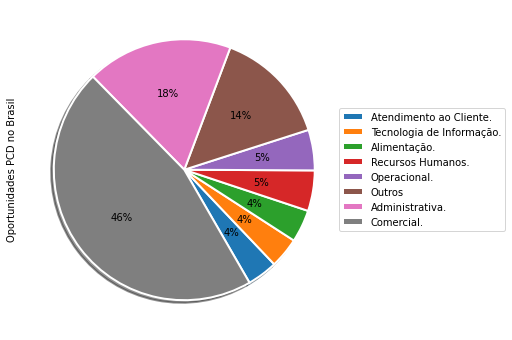

In [10]:
#BRASIL OPORTUNIDADES

#Quando consideramos cada oportunidade, cada linha como sendo individual;

#Vamos agroupar as áreas da vaga que tem percentual do total menor que 2%;
#Para isso, usamos o comando groupby, e contamos quanto possui de vagas para cada tipo:
areavagas = df.groupby("Área da Vaga").agg({"Área da Vaga" : "count"})
#Renomeando a coluna:
areavagas = areavagas.rename(columns={'Área da Vaga' : 'Quantidade de Vagas por Área'})
#Ordenando do maior para o menor valor:
areavagas = areavagas.sort_values(by = ["Quantidade de Vagas por Área"], ascending = False)

#Aplicando a função outros:
func = outros(areavagas , "Quantidade de Vagas por Área" , 2)

#Agora vamos gerar o gráfico:
#Definindo o tamanho da figura:
plt.figure(figsize=(14,6))

#Vamos usar o pacote para definir o tamanho da fonte das legendas:
fontP = FontProperties()
fontP.set_size('small')


plt.subplot(121) #Posição do gráfico
pf = func["Quantidade de Vagas por Área"]
pf.plot.pie(autopct = "%1.0f%%",shadow = True,
           wedgeprops={"linewidth":2,"edgecolor":"white"},
           startangle=300, labels = None)


plt.legend(loc = "center right", bbox_to_anchor=(1.5, 0.5) , labels = func.index )
plt.ylabel('Oportunidades PCD no Brasil')
plt.show()

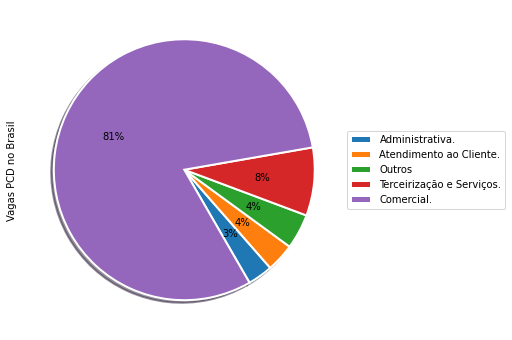

In [11]:
#BRASIL VAGAS

#Quando consideramos o número de vagas dentro de cada oportunidade;
#Temos primeiro que converter a variável "Quantidade de Vagas" pra numérica:

df["Quantidade de Vagas"] = pd.to_numeric(df["Quantidade de Vagas"], errors= "coerce")

#Vamos agroupar as áreas da vaga que tem percentual do total menor que 2%;
#Para isso, usamos o comando groupby, e contamos quanto possui de vagas para cada tipo:
areavagas = df.groupby("Área da Vaga").agg({"Quantidade de Vagas" : "sum"})
#Renomeando a coluna:
areavagas = areavagas.rename(columns={'Quantidade de Vagas' : 'Quantidade de Vagas por Área'})
#Ordenando do maior para o menor valor:
areavagas = areavagas.sort_values(by = ["Quantidade de Vagas por Área"], ascending = False)


func = outros(areavagas, "Quantidade de Vagas por Área" , 2)

#Agora vamos gerar o gráfico:
#Definindo o tamanho da figura:
plt.figure(figsize=(14,6))

#Vamos usar o pacote para definir o tamanho da fonte das legendas:
fontP = FontProperties()
fontP.set_size('small')


plt.subplot(121) #Posição do gráfico
pf = func["Quantidade de Vagas por Área"]
pf.plot.pie(autopct = "%1.0f%%",shadow = True,
           wedgeprops={"linewidth":2,"edgecolor":"white"},
           startangle=300, labels = None)


plt.legend(loc = "center right", bbox_to_anchor=(1.5, 0.5),  labels = func.index )
plt.ylabel('Vagas PCD no Brasil')
plt.show()

In [12]:
#REGIÕES OPORTUNIDADES

#Quando consideramos cada oportunidade, cada linha como sendo individual;

#Construindo as Regiões para dividir a base (estas siglas estão de acordo com a variável prefixo da base):
regS = ["Pr", "Sc", "Rs"]
regSE = ["Sp" , "Rj" , "Es", "Mg"]
regCO = ["Df" , "Go" , "Mt" , "Ms"]
regN = ["Am" , "Rr" , "Ro" , "To" , "Ac" , "Ap" , "Pa"]
regNE = ["Rn", "Ce" , "Pe" , "Ba" , "Al" , "Se" , "Ma" , "Pb" , "Pi"]
Regioes = [regS, regSE, regCO, regN, regNE]
#Agora, criando uma variável na mesma ordem da variável Regioes, mas com strings para podermos usar o nome delas na tabela:
Nomes = ["Sul", "Sudeste" , "Centro-Oeste", "Norte" , "Nordeste" ]

#Queremos criar uma tabela com a distribuição das vagas ao longo do Brasil + detalhado por cada região;
#Como definimos antes, a base do Brasil inteiro é dada por (apenas substituindo areavagas por areavagasbrasil):
areavagasbrasil = df.groupby("Área da Vaga").agg({"Área da Vaga": "count"})
areavagasbrasil = areavagasbrasil.rename(columns={'Área da Vaga' : 'Brasil'})
areavagasbrasil = areavagasbrasil.sort_values(by = ["Brasil"], ascending = False)
Baseregioesop = areavagasbrasil


#Calculando para as regiões, precisamos fazer um loop, pegando nas duas listas definidas acima cada região;
#Usamos o zip para combinar a lista de Nomes com a lista de Regioes;
for nome, regiao in zip(Nomes, Regioes):
#Vamos pegar dentro da base determinado prefixo que está dentro daquela região, como ta dentro do loop, faz pra cada região;
#Dai agrega as áreas da vaga, utilizando groupby e agregando através da contagem de cada uma;
#Vamos pegar dentro da base df somente as observações que tem o prefixo dentro da lista, que está dentro da região "is in":
    areavagasregioes = df[df["prefixo"].isin(regiao)].groupby("Área da Vaga").agg({"Área da Vaga" : "count"})
#Queremos que apareça como nome da variável em cima, cada região:
    areavagasregioes = areavagasregioes.rename(columns={'Área da Vaga' : nome})
#Ordenando do maior para o menor valor:
    areavagasregioes = areavagasregioes.sort_values(by = [nome], ascending = False)
#Dando um merge entre a base do Brasil e o de cada região, sendo que a região que não tem vaga em determinada área recebe 0:
    Baseregioesop = pd.merge(Baseregioesop, areavagasregioes, how = "left", left_index=True, right_index=True).fillna(0)

#Somando por coluna, para obtermos o total de vagas por região:
#Baseregioes.loc['Total',:]= Baseregioes.sum(axis=0)
#Precisamos comentar pra não dar problema no grafico;
Baseregioesop

,Brasil,Sul,Sudeste,Centro-Oeste,Norte,Nordeste
Área da Vaga,,,,,,
Comercial.,183,28.0,130.0,23.0,0.0,2.0
Administrativa.,72,18.0,37.0,10.0,0.0,7.0
Recursos Humanos.,20,3.0,11.0,2.0,1.0,3.0
Operacional.,20,4.0,16.0,0.0,0.0,0.0
Alimentação.,16,9.0,6.0,0.0,0.0,1.0
Atendimento ao Cliente.,15,0.0,11.0,0.0,1.0,3.0
Tecnologia de Informação.,15,2.0,9.0,4.0,0.0,0.0
Terceirização e Serviços.,7,0.0,7.0,0.0,0.0,0.0
Telecomunicações.,7,0.0,0.0,5.0,0.0,2.0


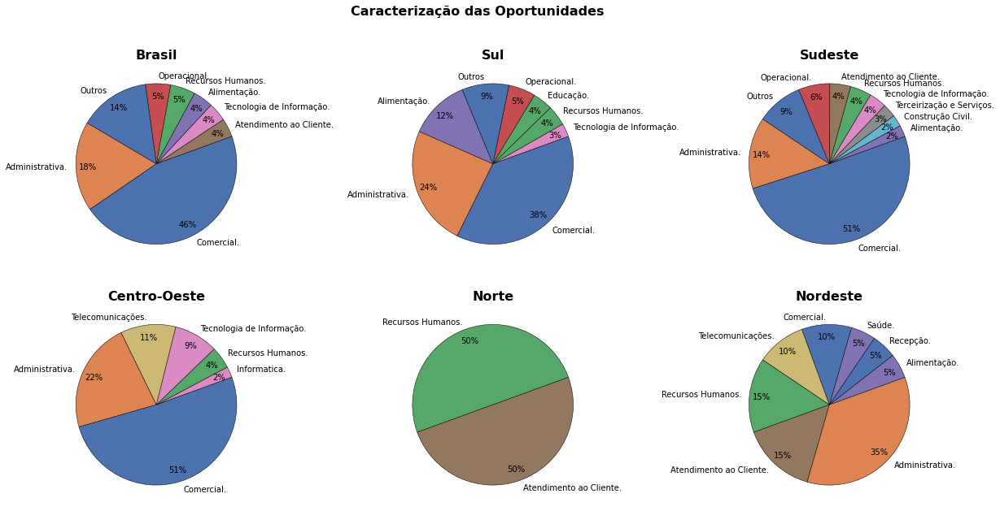

In [13]:
#Por oportunidade:

fontP = FontProperties()
fontP.set_size('small')

#Definindo cores dos gráficos:
clist = {i:j for i, j in zip(Baseregioesop.index.tolist() + ["Outros"], sns.color_palette(palette = 'deep',n_colors=len(Baseregioesop.index.tolist() + ["Outros"])))}


plt.figure(figsize=(21,10))

for i,j in zip(list(Baseregioesop), range(len(list(Baseregioesop)))):

    func = outros(Baseregioesop, i , 2)

    plt.subplot(2,3,j+1)
    pf = func[i]
    pf.plot.pie(autopct = "%1.0f%%", #shadow = True,
            wedgeprops={"linewidth":0.5,"edgecolor":"black"}, colors=[clist[v] for v in func[i].index.tolist()] ,
            startangle=20, pctdistance = 0.85)
    plt.title(label = i , fontdict = {'fontsize': 16, 'fontweight' : 'bold'})
    plt.axis('off')

plt.suptitle('Caracterização das Oportunidades', fontsize = 16, fontweight = 'bold')
plt.show()

In [14]:
#REGIÕES VAGAS

#Quando consideramos o número de vagas dentro de cada oportunidade;
#Temos primeiro que converter a variável "Quantidade de Vagas" pra numérica:

df["Quantidade de Vagas"] = pd.to_numeric(df["Quantidade de Vagas"], errors= "coerce")

#Construindo as Regiões para dividir a base (estas siglas estão de acordo com a variável prefixo da base):
regS = ["Pr", "Sc", "Rs"]
regSE = ["Sp" , "Rj" , "Es", "Mg"]
regCO = ["Df" , "Go" , "Mt" , "Ms"]
regN = ["Am" , "Rr" , "Ro" , "To" , "Ac" , "Ap" , "Pa"]
regNE = ["Rn", "Ce" , "Pe" , "Ba" , "Al" , "Se" , "Ma" , "Pb" , "Pi"]
Regioes = [regS, regSE, regCO, regN, regNE]
#Agora, criando uma variável na mesma ordem da variável Regioes, mas com strings para podermos usar o nome delas na tabela:
Nomes = ["Sul", "Sudeste" , "Centro-Oeste", "Norte" , "Nordeste" ]


#Queremos criar uma tabela com a distribuição das vagas ao longo do Brasil + detalhado por cada região;
#Como definimos antes, a base do Brasil inteiro é dada por (apenas substituindo areavagas por areavagasbrasil):
areavagasbrasil = df.groupby("Área da Vaga").agg({"Quantidade de Vagas": "sum"})
areavagasbrasil = areavagasbrasil.rename(columns={'Quantidade de Vagas' : 'Brasil'})
areavagasbrasil = areavagasbrasil.sort_values(by = ["Brasil"], ascending = False)
Baseregioesqtd = areavagasbrasil

#Calculando para as regiões, precisamos fazer um loop, pegando nas duas listas definidas acima cada região;
#Usamos o zip para combinar a lista de Nomes com a lista de Regioes;
for nome, regiao in zip(Nomes, Regioes):
#Vamos pegar dentro da base determinado prefixo que está dentro daquela região, como ta dentro do loop, faz pra cada região;
#Dai agrega as áreas da vaga, utilizando groupby e agregando através da contagem de cada uma;
    areavagasregioes = df[df["prefixo"].isin(regiao)].groupby("Área da Vaga").agg({"Quantidade de Vagas" : "sum"})
#Queremos que apareça como nome da variável em cima, cada região:
    areavagasregioes = areavagasregioes.rename(columns={'Quantidade de Vagas' : nome})
#Ordenando do maior para o menor valor:
    areavagasregioes = areavagasregioes.sort_values(by = [nome], ascending = False)
#Dando um merge entre a base do Brasil e o de cada região, sendo que a região que não tem vaga em determinada área recebe 0:
    Baseregioesqtd = pd.merge(Baseregioesqtd, areavagasregioes, how = "left", left_index=True, right_index=True).fillna(0)

#Somando por coluna, para obtermos o total de vagas por região:
#Baseregioes.loc['Total',:]= Baseregioes.sum(axis=0)
#Precisamos comentar pra não dar problema no grafico;
Baseregioesqtd

,Brasil,Sul,Sudeste,Centro-Oeste,Norte,Nordeste
Área da Vaga,,,,,,
Comercial.,6680.0,1067.0,4882.0,651.0,0.0,80.0
Terceirização e Serviços.,700.0,0.0,700.0,0.0,0.0,0.0
Atendimento ao Cliente.,291.0,0.0,191.0,0.0,25.0,75.0
Administrativa.,258.0,43.0,154.0,34.0,0.0,27.0
Telecomunicações.,104.0,0.0,0.0,100.0,0.0,4.0
Operacional.,58.0,4.0,54.0,0.0,0.0,0.0
Alimentação.,48.0,25.0,22.0,0.0,0.0,1.0
Tecnologia de Informação.,36.0,10.0,16.0,10.0,0.0,0.0
Recursos Humanos.,20.0,3.0,11.0,2.0,1.0,3.0


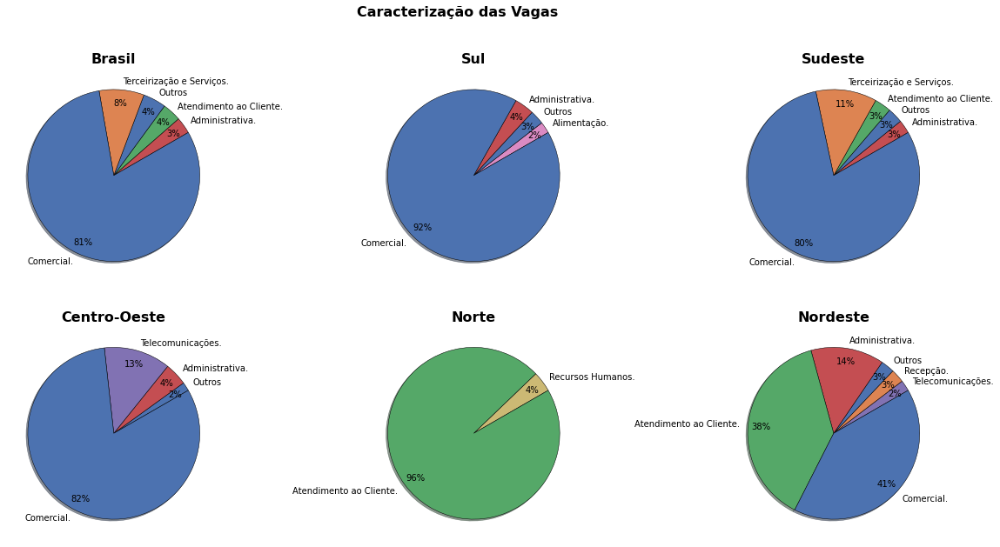

In [15]:
#Por quantidade de vagas dentro da mesma oportunidade:

fontP = FontProperties()
fontP.set_size('small')


#Definindo cores dos gráficos:
clist = {i:j for i, j in zip(Baseregioesqtd.index.tolist() + ["Outros"], sns.color_palette(palette = 'deep',n_colors=len(Baseregioesqtd.index.tolist() + ["Outros"])))}


plt.figure(figsize=(21,10))

for i,j in zip(list(Baseregioesqtd), range(len(list(Baseregioesqtd)))):
    
    func = outros(Baseregioesqtd, i , 2)

    plt.subplot(2,3,j+1)
    pf = func[i]
    pf.plot.pie(autopct = "%1.0f%%",shadow = True,
            wedgeprops={"linewidth":0.5,"edgecolor":"black"}, colors=[clist[v] for v in func[i].index.tolist()] ,
            startangle=30, pctdistance = 0.85)
    plt.title(label = i , fontdict = {'fontsize': 16, 'fontweight' : 'bold'})
    plt.axis('off')

plt.suptitle('Caracterização das Vagas', fontsize = 16, fontweight = 'bold')
plt.show()

#### - Empresas

In [16]:
print(df["nom_empresa"].unique())

['Sodimac' 'Poupacred ' 'Empresa Confidencial'
 'Smartfit Escola de Ginastica e Danca S.A' 'PORTOBELLO SHOP'
 'PRATIKA TERCEIRIZAÇÃO EM SERVIÇOS' 'LUBRIZOL DO BRASIL'
 'Martinelli Advocacia Empresarial' 'Mars Brasil' 'P&G' 'DeficienteOnline'
 'TABOCAS' 'BRBPO TECNOLOGIA' 'Takeda Pharmaceutical' 'Bom Jesus'
 'TUSSOR CONFECÇÕES LTDA' 'Arteris S.A' 'Risotolândia' 'Pluris Midia'
 'ACOS MACOM INDUSTRIA E COMERCIO LTDA'
 'ENGELUZ ILUMINAÇÃO E ELETRICIDADE - EIRELI' 'FOTON INFORMATICA'
 'SAP BRASIL' 'REDE CONECTA' 'Raizen' 'Bom Jesus Agro'
 'WLM PARTICIPAÇÕES E COMÉRCIO\xa0DE\xa0MÁQUINAS E VEÍCULOS S.A.'
 'Hyundai Caoa' 'Colégio Medianeira contrata:' 'SERPCD - Inclusão Social'
 'MARTINS SLIM' 'JCI - Johnson Controls' 'ORMEC ENGENHARIA LTDA'
 'Teleperformance CRM/SA' 'MANSERV FACILITIES ' 'C&A Modas S.A'
 'GMS Management Solutions Consultoria Brasil Ltda' 'Elumini Outdoing IT'
 'MetLife']


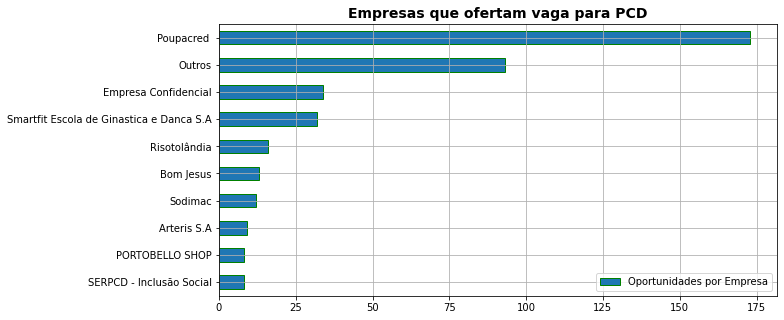

In [17]:
#Empresas por oportunidade

#Vamos agregar a empresa com o total de vagas que esta oferece, a partir de quantas vezes ela aparece na variável nom_empresa:
empresas = df.groupby("nom_empresa").agg({"nom_empresa" : "count"})
#Renomeando a coluna:
empresas = empresas.rename(columns={'nom_empresa' : 'Oportunidades por Empresa'})
#Ordenando do maior para o menor valor:
empresas = empresas.sort_values(by = ["Oportunidades por Empresa"], ascending = False)
empresas

func = outros(empresas, "Oportunidades por Empresa", 2)

#Agora vamos gerar o gráfico:
#plt.figure(figsize=(14,6))
#Vamos usar o pacote para definir o tamanho da fonte das legendas:
fontP = FontProperties()
fontP.set_size('medium')
#Posição do gráfico
func.plot(kind="barh",stacked=True, figsize=(10,5), edgecolor= "green", linewidth="1")
plt.title(label = "Empresas que ofertam vaga para PCD", fontdict = {'fontsize': 14, 'fontweight' : 'bold'})
plt.legend(loc = "lower right" , prop = fontP)
plt.ylabel("", fontsize = 14)
plt.grid()
plt.show()

In [18]:
#Dando uma olhada na lista de empresas que ofertam oportunidades de vagas  para deficientes:
empresas

,Oportunidades por Empresa
nom_empresa,
Poupacred,173
Empresa Confidencial,34
Smartfit Escola de Ginastica e Danca S.A,32
Risotolândia,16
Bom Jesus,13
Sodimac,12
Arteris S.A,9
SERPCD - Inclusão Social,8
PORTOBELLO SHOP,8


#### - Ocupações

In [19]:
print(df["den_titulo"].unique())

['Fiscal de Prevenção de Perdas | Sodimac Osasco PCD'
 'Consultor de vendas PCD' 'Analista de Recursos Humanos - DHO PCD'
 'Vendedor de Consignado PCD' 'Recepcionista PCD'
 '(BANCO DE TALENTOS) Assistente Administrativo PCD'
 'Auxiliar de limpeza PCD' 'Operador de Caixa | Sodimac Guarulhos PCD'
 'ANALISTA DE OPERAÇÕES - RH PCD' 'Analista de Recrutamento e Seleção PCD'
 'ASSISTENTE COMERCIAL \x96 JOINVILLE PCD' 'Promotor de vendas PCD'
 'Operador de Negócios PCD' 'Coordenador de Vendas PCD'
 'Analista Administrativo Pleno PCD'
 'Consultor Tributário Júnior - Porto Alegre PCD'
 'Assessor de Vendas | Setor Pisos e Revestimentos | Sodimac Guarulhos | 44h PCD'
 'Banco de Talentos PCD' 'Consultor de credito consignado PCD'
 'ASSISTENTE ADMINISTRATIVO JR PCD' 'Operador de Telemarketing PCD PCD'
 'Diretor Médico Associado - Vacinas PCD' 'Auxiliar Adiministrativo PCD'
 'Programador Developer Node.js PCD' 'Assistente de Produção PCD'
 'Operador de Caixa | Sodimac Osasco | 30hs | PCD PCD'
 'Assis

In [20]:
#Vamos analisar o número de oportunidades oferecidas por ocupação;
ocupacoes = df.groupby("den_titulo").agg({"den_titulo" : "count"})
#Renomeando a coluna:
ocupacoes = ocupacoes.rename(columns={'den_titulo' : 'Ocupações'})
#Ordenando do maior para o menor valor:
ocupacoes = ocupacoes.sort_values(by = ["Ocupações"], ascending = False)
#Dando uma olhada nas cinco principais ocupações:
ocupacoes.head()

,Ocupações
den_titulo,
Consultor de vendas PCD,60
Promotor de vendas PCD,52
Vendedor de Consignado PCD,49
Recepcionista PCD,33
Banco de Talentos PCD,14


#### - Escolaridade

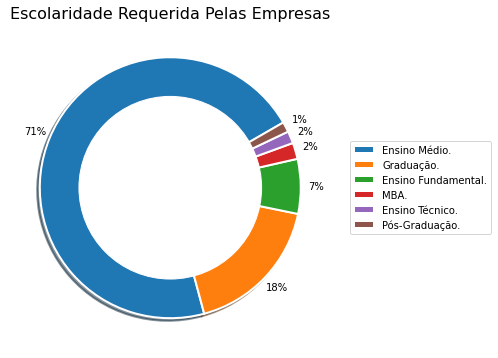

In [21]:
#Faremos uma análise gráfica sobre quais os níveis de escolaridade mínima são requisitados;
#Escolaridade por oportunidade
escolaridade = df.groupby("Escolaridade Mínima").agg({"Escolaridade Mínima" : "count"})
#Renomeando a coluna:
escolaridade = escolaridade.rename(columns={'Escolaridade Mínima' : 'Escolaridade Requerida'})
#Ordenando do maior para o menor valor:
escolaridade = escolaridade.sort_values(by = ["Escolaridade Requerida"], ascending = False)

#Posição do gráfico

plt.figure(figsize=(14,6))

#Vamos usar o pacote para definir o tamanho da fonte das legendas:
fontP = FontProperties()
fontP.set_size('small')


plt.subplot(111) #Posição do gráfico
pf = escolaridade["Escolaridade Requerida"]
pf.plot.pie(autopct = "%1.0f%%",shadow = True,
         wedgeprops={"linewidth":2,"edgecolor":"white"},
         startangle=30, labels = None , pctdistance = 1.12)
plt.legend(loc = "center right", bbox_to_anchor=(1.5, 0.5) , labels = escolaridade.index )
plt.ylabel("")


my_circ = plt.Circle((0,0),.7,color = "white") 
plt.gca().add_artist(my_circ)

plt.title("Escolaridade Requerida Pelas Empresas" , fontsize = 16)

plt.show()

#### - Habilidades Requeridas

In [35]:
conda install -c conda-forge wordcloud

Solving environment: ...working... done

## Package Plan ##

  environment location: C:\Users\ferna\anaconda3

  added / updated specs:
    - wordcloud


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    wordcloud-1.8.1            |   py38h294d835_1         196 KB  conda-forge
    ------------------------------------------------------------
                                           Total:         196 KB

The following NEW packages will be INSTALLED:

  wordcloud          conda-forge/win-64::wordcloud-1.8.1-py38h294d835_1

The following packages will be SUPERSEDED by a higher-priority channel:

  conda               pkgs/main::conda-4.9.2-py38haa95532_0 --> conda-forge::conda-4.9.2-py38haa244fe_0




wordcloud-1.8.1      | 196 KB    |            |   0% 
wordcloud-1.8.1      | 196 KB    | 8          |   8% 
wordcloud-1.8.1      | 196 KB    | ########## | 100% 
wordcloud-1.8.1      | 196 KB 

In [37]:
pip install unidecode

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\ferna\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


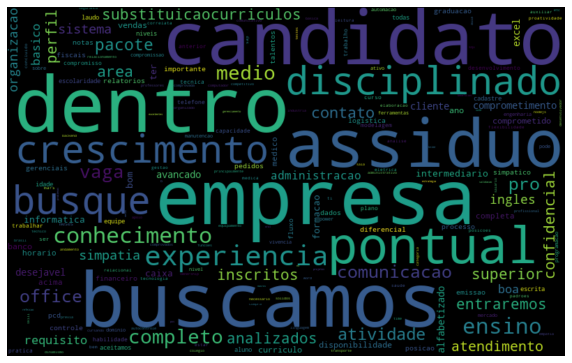

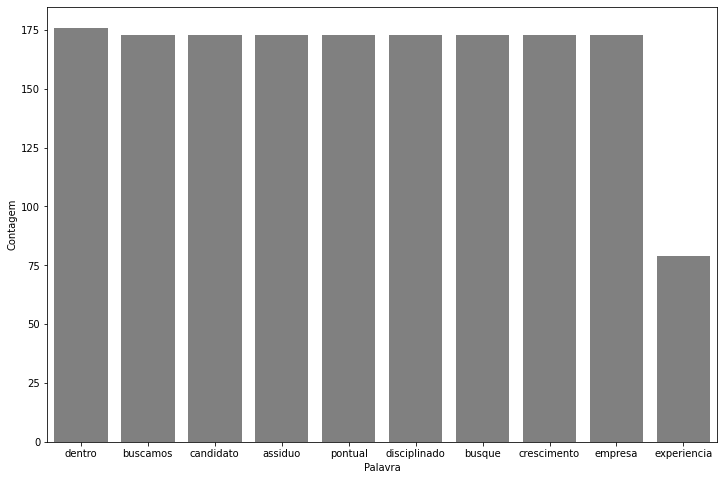

In [22]:
#Análise, via nuvem de palavras, para verificarmos quais as palavras que mais aparecem;
#Importando os pacotes necessários para fazer a nuvem:
from wordcloud import WordCloud
from nltk import tokenize
from nltk.tokenize import WhitespaceTokenizer
from sklearn.feature_extraction.text import CountVectorizer
import matplotlib.pyplot as plt
import nltk
nltk.download('stopwords')
import unidecode
from string import punctuation

#Dando o nome de tabela para a base, lendo ela:
tabela = pd.read_pickle("vagaspcd.pkl")

#Renomeando as colunas:
tabela.rename(columns={'Habilidades requeridas': 'habilidades_requeridas'}, inplace = True)

#Criando a função para tokenizar as frases, para quebrar a frase em palavras:
token_espaco = WhitespaceTokenizer().tokenize

#Retirando as palavras irrelevantes para a análise, como, por exemplo, de, e:
palavras_irrelevantes = nltk.corpus.stopwords.words("portuguese")
#Criando uma lista vazia:
frase_processada = list()
#Fazendo um loop na coluna de habilidades requeridas:
for vaga in tabela.habilidades_requeridas:
    nova_frase = list()
#Usando a função que criamos:
    palavra_texto = token_espaco(vaga)
    for palavra in palavra_texto:
        if palavra not in palavras_irrelevantes:
            nova_frase.append(palavra)
            
    frase_processada.append(' '.join(nova_frase))

tabela["tratamento_1"] = frase_processada

# Retirando a pontuação do texto

pontuacao = list()

token_pontuacao = tokenize.WordPunctTokenizer()

for ponto in punctuation:
    pontuacao.append(ponto)

pontuacao_stopwords = pontuacao + palavras_irrelevantes
    
frase_processada = list()

for opiniao in tabela["tratamento_1"]:
    nova_frase = list()
    palavras_texto = token_pontuacao.tokenize(opiniao)
    for palavra in palavras_texto:
        if palavra not in pontuacao_stopwords:
            nova_frase.append(palavra)
    frase_processada.append(' '.join(nova_frase))
    
tabela['tratamento_2'] = frase_processada

#Retirando a acentuação das palavras:

sem_acentos = [unidecode.unidecode(texto) for texto in tabela["tratamento_2"]]
stopwords_sem_acento = [unidecode.unidecode(texto) for texto in pontuacao_stopwords]
tabela["tratamento_3"] = sem_acentos

frase_processada = list()

for opiniao in tabela["tratamento_3"]:
    nova_frase = list()
    palavras_texto = token_pontuacao.tokenize(opiniao)
    for palavra in palavras_texto:
        if palavra not in stopwords_sem_acento:
            nova_frase.append(palavra)
    frase_processada.append(' '.join(nova_frase))
    
tabela['tratamento_3'] = frase_processada

# Transformando todas as letras em minúsculas:

tabela["tratamento_3"] = sem_acentos

frase_processada = list()

for opiniao in tabela["tratamento_3"]:
    nova_frase = list()
    opiniao = opiniao.lower()
    palavras_texto = token_pontuacao.tokenize(opiniao)
    for palavra in palavras_texto:
        if palavra not in stopwords_sem_acento:
            nova_frase.append(palavra)
    frase_processada.append(' '.join(nova_frase))
    
tabela['tratamento_4'] = frase_processada

#Fazendo a nuvem de palavras:

todas_palavras = ' '.join([texto for texto in tabela['tratamento_4']])

nuvem_palavras = WordCloud(width = 800, height = 500,
                          max_font_size= 110,
                          collocations = False).generate(todas_palavras)
plt.figure(figsize= (10, 7))
plt.imshow(nuvem_palavras, interpolation='bilinear')
plt.axis('off')
plt.show()

#definindo a função que irá fazer o gráfico de barras:
def pareto(texto, coluna_texto, quantidade):
    todas_palavras = ' '.join([texto for texto in texto[coluna_texto]])

    token_frase = token_espaco(todas_palavras)
    frequencia = nltk.FreqDist(token_frase)
    df_frequencia = pd.DataFrame({"Palavra" : list(frequencia.keys()),
                                 "Frequencia": list(frequencia.values())})

    df_frequencia = df_frequencia.nlargest(columns = "Frequencia", n = quantidade)
    plt.figure(figsize = (12, 8))
    ax = sns.barplot(data = df_frequencia, x = "Palavra", y = "Frequencia",
                    color = "grey")

    ax.set(ylabel = "Contagem")
    plt.show()
#Gráfico de barras das palavras mais usadas:    
pareto(tabela,"tratamento_4", 10)

#### - Estados

In [ ]:
#Aqui iremos fazer uma análise via mapa, gerando um mapa de cores iterativo para o Brasil todo, difereciando os estados;

In [12]:
conda install -c plotly plotly=4.14.3 #instalando o pacote plotly

Solving environment: ...working... done

## Package Plan ##

  environment location: C:\Users\ferna\anaconda3

  added / updated specs:
    - plotly=4.14.3


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    plotly-4.14.3              |             py_0         5.9 MB  plotly
    retrying-1.3.3             |             py_2          14 KB
    ------------------------------------------------------------
                                           Total:         5.9 MB

The following NEW packages will be INSTALLED:

  plotly             plotly/noarch::plotly-4.14.3-py_0
  retrying           pkgs/main/noarch::retrying-1.3.3-py_2




plotly-4.14.3        | 5.9 MB    |            |   0% 
plotly-4.14.3        | 5.9 MB    | ########## | 100% 
plotly-4.14.3        | 5.9 MB    | ########## | 100% 

retrying-1.3.3       | 14 KB     |            |   0% 
retrying-1.3.3       | 14 KB     | ########## |

In [23]:
import os
import pandas as pd
os.chdir("C:/Users/ferna/Desktop/Documentos/Pos-Graduacao/Programação/Trabalho")
df = pd.read_pickle("vagaspcd.pkl")

In [24]:
#Importando alguns pacotes:
import plotly as plty
import plotly.express as px
import json
from urllib.request import urlopen
import pandas as pd
import shapefile

In [25]:
#Pegando total de oportunidades por estado:
total = df.groupby('prefixo').agg({'prefixo':'count'})
#Definindo as siglas dos estados para que o estado que não tenha vaga tenha preenchimento zero:
br = ["Pr", "Sc", "Rs","Sp" , "Rj" , "Es", "Mg","Df" , "Go" , "Mt" , "Ms",
      "Am" , "Rr" , "Ro" , "To" , "Ac" , "Ap" , "Pa","Rn", "Ce" , "Pe" , "Ba" ,
      "Al" , "Se" , "Ma" , "Pb" , "Pi"]

suporte = total.transpose()
#Fazendo um loop para o preenchimento:
for estado in br:
    if estado in total.index.tolist():
        continue
    else:
        suporte[estado] = 0
total = suporte.transpose()
#Convertendo as siglas para maiuscula:
total.index = total.index.str.upper()        
total["Estado"] = total.index
#Renomeando a coluna:
total = total.rename(columns={'prefixo' : 'Oportunidades'})
#Pegando o arquivo shape para fazer o gráfico:
with shapefile.Reader("lim_unidade_federacao_a.shp") as shp:
    Brasil = shp.__geo_interface__
#Fazendo um loop nas 'features' que existem dentro do shape:
for feature in Brasil['features']:
    feature['id'] = feature['properties']['sigla']

#Agora, criando o mapa:    
fig = px.choropleth(total, #tabela de dados usada pelo mapa
    locations = 'Estado', #definindo o limite no mapa
    geojson = Brasil, #informação do shape
    color_continuous_scale=px.colors.sequential.Agsunset[::-1], #escolhendo as cores
    color = "Oportunidades", #definindo que a escala das cores será de acordo com os estados
    hover_name = 'Estado', 
    hover_data =['Estado'], #o nome da sigla
    title = "Oportunidades de Vagas de Trabalho PCD por Estado", #título do mapa
)
fig.update_geos(fitbounds = "locations", visible = False)
fig.show()
#Passe o mouse pelo mapa e veja a interação acontecendo;

#### - Salários

In [ ]:
#Sobre a distribuição dos salários propostos aos deficientes
#Temos três variáveis: salário inicial, salário final e faixa salarial;
#Pensamos, inicialmente, em analisar alguma dispersão por salário inicial e o mesmo para salário final.

In [26]:
a = pd.DataFrame(df["salario_inicial"].unique())
a

,0
0,"R$ 724,00"
1,"R$ 1.000,00"
2,"R$ 3.000,00"
3,"R$ 1.300,00"
4,"R$ 620,00"
5,"R$ 5.000,00"
6,None
7,"R$ 6.000,00"
8,"R$ 2.100,00"
9,"R$ 2.500,00"


In [27]:
%%capture
#Usamos o comando acima para não dar problema ao rodar;
#Chamando de a, a coluna de salario inicial:
a= df[["salario_inicial"]]
#Criando outra coluna, onde vamos mudar o sistema de pontuações de brasileiro pra americano pra não dar erro;
#Primeiro queremos tirar o R$, pegamos em cada linha a partir da terceira casa, que será a partir do primeiro número;
#Depois a gente quer que ,00 no final seja dropado, para ajudar na conversão;
#Por último, substituimos todas os pontos por nada;
a["salarioin"]= a["salario_inicial"].str[3:].str[:-3].str.replace("." , "")
#Agora precisamos converter a variavel para numerica:
a["salarioin"] = pd.to_numeric(a["salarioin"], errors= "coerce")

In [28]:
a

,salario_inicial,salarioin
0,"R$ 724,00",724.0
1,"R$ 1.000,00",1000.0
2,"R$ 3.000,00",3000.0
3,"R$ 1.000,00",1000.0
4,"R$ 1.000,00",1000.0
...,...,...
1,"R$ 10.000,00",10000.0
2,"R$ 10.000,00",10000.0
0,"R$ 6.000,00",6000.0
0,"R$ 1.300,00",1300.0


In [29]:
print(df["salario_final"].unique())

['R$ 1.300,00' 'R$ 1.800,00' 'R$ 4.000,00' 'R$ 5.000,00' None
 'R$ 8.000,00' 'R$ 1.000,00' 'R$ 10.000,00' 'R$ 3.000,00' 'R$ 2.500,00'
 'R$ 2.100,00' 'R$ 6.000,00' 'R$ 30.000,00' 'R$ 12.000,00']


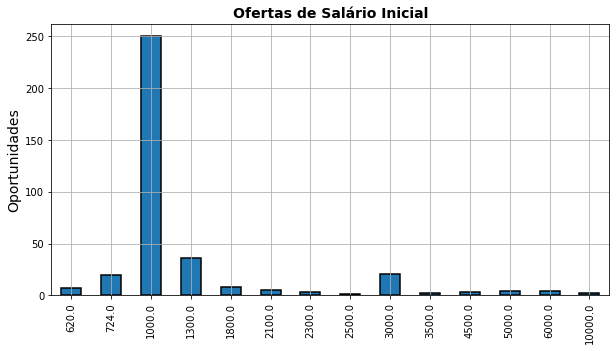

In [30]:
#Vamos agregar os salarios iniciais de acordo com o total de oportunidades:
salarioin = a.groupby("salarioin").agg({"salarioin" : "count"})
#Renomeando a coluna:
salarioin = salarioin.rename(columns={'salarioin' : 'Ofertas de Salario Inicial'})
#Ordenando do maior para o menor valor:
salarioin = salarioin.sort_index(ascending = True)

#Agora vamos gerar o gráfico:
salarioin.plot(kind="bar",stacked=True, figsize=(10,5), edgecolor= "black", linewidth="1.5", legend=None)
plt.title(label = "Ofertas de Salário Inicial", fontdict = {'fontsize': 14, 'fontweight' : 'bold'})
plt.ylabel("Oportunidades", fontsize = 14)
plt.xlabel("")
plt.grid()
plt.show()

In [31]:
%%capture
#Usamos o comando acima para não dar problema ao rodar;
#Fazendo a mesma coisa acima para o salário final proposto:
#Chamando de a, a coluna de salario inicial:
a= df[["salario_final"]]
#Criando outra coluna, onde vamos mudar o sistema de pontuações de brasileiro pra americano pra não dar erro;
#Primeiro queremos tirar o R$, pegamos em cada linha a partir da terceira casa, que será a partir do primeiro número;
#Depois a gente quer que ,00 no final seja dropado, para ajudar na conversão;
#Por último, substituimos todas os pontos por nada;
a["salariofi"]= a["salario_final"].str[3:].str[:-3].str.replace("." , "")
#Agora precisamos converter a variavel para numerica:
a["salariofi"] = pd.to_numeric(a["salariofi"], errors= "coerce")

In [32]:
a

,salario_final,salariofi
0,"R$ 1.300,00",1300.0
1,"R$ 1.800,00",1800.0
2,"R$ 4.000,00",4000.0
3,"R$ 1.800,00",1800.0
4,"R$ 1.300,00",1300.0
...,...,...
1,"R$ 12.000,00",12000.0
2,"R$ 12.000,00",12000.0
0,"R$ 8.000,00",8000.0
0,"R$ 1.800,00",1800.0


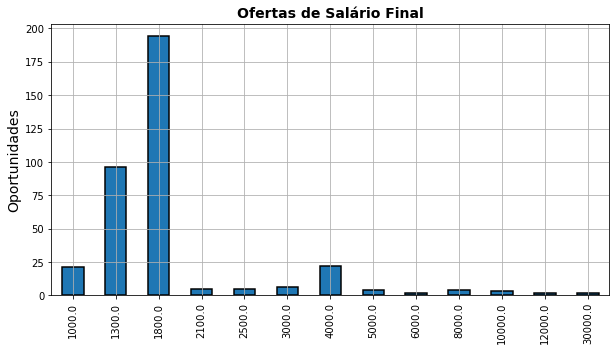

In [33]:
#Vamos agregar os salarios finais de acordo com o total de oportunidades:
salariofi = a.groupby("salariofi").agg({"salariofi" : "count"})
#Renomeando a coluna:
salariofi = salariofi.rename(columns={'salariofi' : 'Ofertas de Salario Final'})
#Ordenando do maior para o menor valor:
salariofi = salariofi.sort_index(ascending = True)

#Agora vamos gerar o gráfico:
salariofi.plot(kind="bar",stacked=True, figsize=(10,5), edgecolor= "black", linewidth="1.5", legend=None)
plt.title(label = "Ofertas de Salário Final", fontdict = {'fontsize': 14, 'fontweight' : 'bold'})
plt.ylabel("Oportunidades", fontsize = 14)
plt.xlabel("")
plt.grid()
plt.show()

#### - Tipo de Deficiência

In [ ]:
#Analisar quais tipos de deficiência são mais requisitados.

In [34]:
print(df["Deficiência"].unique())

['Não informado.'
 'Auditivo,                                                      Fisica,                                                      Fisica,                                                      Fisica,                                                      Visual.'
 'Auditivo,                                                      Fisica,                                                      Fisica,                                                      Visual.'
 'Auditivo,                                                      Auditivo,                                                      Auditivo,                                                      Fisica,                                                      Fisica,                                                      Fisica,                                                      Fisica,                                                      Fisica,                                                      Fisica,                          

In [36]:
%%capture
#Usamos o comando acima para não dar problema ao rodar;
#Retirando o espaço entre os tipos de deficiência e o ponto no final:
defic= df[["Deficiência"]]
defic["deficiencia"]= defic["Deficiência"].str.replace(" " , "").str.replace(".", "")
#Criando uma lista de deficiências:
tiposdeficiencia = ['Nãoinformado', 'Auditivo', 'Fisica', 'Visual', 'Mental', 'Outros']
#Fazendo um loop:
for tipos in tiposdeficiencia:
    defic.loc[defic['deficiencia'].str.contains(tipos),tipos]=1
    defic[tipos]= defic[tipos].fillna(0) #substituindo onde tem NaN por zero

In [37]:
defic

,Deficiência,deficiencia,Nãoinformado,Auditivo,Fisica,Visual,Mental,Outros
0,Não informado.,Nãoinformado,1.0,0.0,0.0,0.0,0.0,0.0
1,"Auditivo, ...","Auditivo,Fisica,Fisica,Fisica,Visual",0.0,1.0,1.0,1.0,0.0,0.0
2,Não informado.,Nãoinformado,1.0,0.0,0.0,0.0,0.0,0.0
3,"Auditivo, ...","Auditivo,Fisica,Fisica,Visual",0.0,1.0,1.0,1.0,0.0,0.0
4,Não informado.,Nãoinformado,1.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...
1,Não informado.,Nãoinformado,1.0,0.0,0.0,0.0,0.0,0.0
2,Não informado.,Nãoinformado,1.0,0.0,0.0,0.0,0.0,0.0
0,"Visual, ...","Visual,Fisica,Outros,Mental,Auditivo",0.0,1.0,1.0,1.0,1.0,1.0
0,Não informado.,Nãoinformado,1.0,0.0,0.0,0.0,0.0,0.0


In [38]:
#Criando uma lista vazia que será preenchida no loop, de acordo com a soma dos tipos de deficiência requisitas por oportunidade:
tipos = []
for types in tiposdeficiencia:
    total = defic[types].sum()
    tipos.append(total)
#A frequência com que aparece se dará pela combinação do nome das variáveis com seu respectivo total somado:
frequencia = pd.DataFrame(dict(zip(tiposdeficiencia, tipos)),index=['Frequência'])
frequencia

,Nãoinformado,Auditivo,Fisica,Visual,Mental,Outros
Frequência,161.0,232.0,236.0,230.0,39.0,48.0


In [39]:
frequencia = frequencia.transpose()

In [40]:
#Agora, precisamos criar um gráfico que demonstre quanto cada tipo de deficiência aparece entre as oportunidades;
#Fazer uma porcentagem, por exemplo, 235/392 das oportunidades aceitam deficientes com tipo "Fisica", etc;
#Criando essa porcentagem:
frequencia['Porcentagem'] = frequencia['Frequência'] / len(df) *100
frequencia['Porcentagem']

Nãoinformado    40.452261
Auditivo        58.291457
Fisica          59.296482
Visual          57.788945
Mental           9.798995
Outros          12.060302
Name: Porcentagem, dtype: float64

In [41]:
frequencia

,Frequência,Porcentagem
Nãoinformado,161.0,40.452261
Auditivo,232.0,58.291457
Fisica,236.0,59.296482
Visual,230.0,57.788945
Mental,39.0,9.798995
Outros,48.0,12.060302


In [42]:
#Dando nome para o índice, para tentar fazer um mosaico com o percentual:
frequencia['index']= frequencia.index
frequencia

,Frequência,Porcentagem,index
Nãoinformado,161.0,40.452261,Nãoinformado
Auditivo,232.0,58.291457,Auditivo
Fisica,236.0,59.296482,Fisica
Visual,230.0,57.788945,Visual
Mental,39.0,9.798995,Mental
Outros,48.0,12.060302,Outros


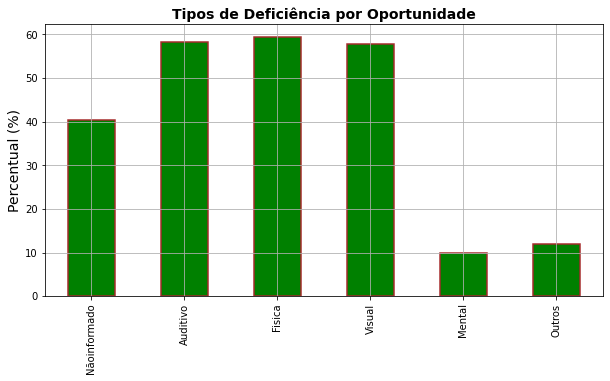

In [43]:
#Fazendo um gráfico de barras, já que o mosaico não funcionou:
frequencia['Porcentagem'].plot(kind="bar",stacked=True, figsize=(10,5), color= "green", edgecolor= "brown", linewidth="1.5", legend=None)
plt.title(label = "Tipos de Deficiência por Oportunidade", fontdict = {'fontsize': 14, 'fontweight' : 'bold'})
plt.ylabel("Percentual (%)", fontsize = 14)
plt.xlabel("")
plt.grid()
plt.show()

## 3. Machine Learnig

#### - Coletando vagas antigas

In [ ]:
codigos = pd.to_numeric(df["id_tc_vagas"] , errors='coerce')

listurl2 = []
for i in range(codigos.max()+1):
    linkini = "https://www.deficienteonline.com.br/emprego-pcd/promotor-de-vendas-pcd-em-araras-sp/"
    listurl2.append(linkini + '{:d}'.format(i + 1).zfill(5))

s = requests.Session()

baseprovi = {}

for link in listurl2:
    segunda = s.get(link)
    segunda_soup = BeautifulSoup(segunda.text, 'lxml')

    codigo = [link[-5:]]

    errado = segunda_soup.find("h1", attrs = { "class" : "mt-5"})

    if errado is None:

        inte = segunda_soup.find_all("div", attrs = { "class" : "col-md-12 ml-1 mr-1"})[1:-1]
        valor = []
        for var in inte:
            valor.append(var.find_all("p")[0].text.strip().replace("\r", "").replace("\n", ""))


        label = []    
        for var in inte:
            label.append(var.find_all("h3")[0].text.strip().replace("\r", "").replace("\n", ""))

        label.append('nom_empresa')
        valor.append(segunda_soup.find_all("u")[0].text)
        detalhes = [dict(zip(label, valor))]

        info = dict(zip(codigo, detalhes))

        baseprovi.update(info)

        print(codigo[0] , "-" ," Vaga coletada.")

    else:
        if (errado.text == "Algo deu errado! :("):
            print(codigo[0], "-" " Vaga inexistente.")
    time.sleep(1)

In [34]:
#Importando pacotes:
import pickle
import re
import codecs
import numpy as np
import pandas as pd
import scipy.sparse as sp
import joblib

In [36]:
%%capture
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.naive_bayes import MultinomialNB
from sklearn.pipeline import Pipeline
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.datasets import load_files
from sklearn import preprocessing
from sklearn.preprocessing import LabelEncoder
import nltk
from nltk import tokenize
from nltk.tokenize import WhitespaceTokenizer
from sklearn.feature_extraction.text import CountVectorizer
from nltk import ngrams
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression

In [37]:
#Abrindo a base de dados
with open("C:/Users/ferna/Desktop/Documentos/Pos-Graduacao/Programação/Trabalho/machinelearning.pkl", 'rb') as f:
    content = f.read()
cache = pickle.loads(content)

In [38]:
len(cache)

22619

In [39]:
cache[20:100]

,Detalhes da Vaga,Informações da empresa,Faixa Salarial,Benefícios,Escolaridade Mínima,Habilidades requeridas,Área da Vaga,Local de trabalho,Quantidade de Vagas,Vigência da vaga,A empresa tem Acessibilidade para PCD?,Deficiência,Observações,nom_empresa,Horas semanais,Idiomas
00118,Toda rotina pertinente a área financeira( nota...,NaN,"R$ 620,00 - R$1,000,00.",NaN,Ensino Médio.,NaN,Financeiro.,Sao paulo / SP,2,Termina em menos de 60 dias,Sim:,Não informado.,"Favor informar:1) Descrição da deficiência, me...",Empresa confidencial,44,NaN
00119,Toda rotina pertinente a área ( lançamentos co...,NaN,"R$ 620,00 - R$1,000,00.",NaN,Ensino Médio.,NaN,Contabilidade.,Sao paulo / SP,2,Termina em menos de 60 dias,Sim:,Não informado.,"Favor informar:1) Descrição da deficiência, me...",Empresa confidencial,44,NaN
00122,Toda rotina pertinente a área administrativa (...,O Grupo Locaweb é Lider na América Latina em s...,"R$ 620,00 - R$1,000,00.",NaN,Ensino Médio.,NaN,Administrativa.,Sao paulo / SP,4,Termina em menos de 60 dias,Sim:,Não informado.,"Favor informar:1) Descrição da deficiência, me...",Locaweb Serviços de Internet S/A,44,NaN
00123,Descrição das Atividades:- Desenvolvimento de ...,O Grupo Locaweb é Lider na América Latina em s...,"R$ 2,100,00 - R$4,000,00.",NaN,Graduação.,Requisitos: - Experiência em programação com a...,Tecnologia de Informação.,Sao paulo / SP,2,Termina em menos de 60 dias,Sim:,Não informado.,"Favor informar: 1) Descrição da deficiência, m...",Locaweb Serviços de Internet S/A,NaN,NaN
00124,Configuração de bancos de dados MsSQL Server p...,O Grupo Locaweb é Lider na América Latina em s...,"R$ 2,100,00 - R$4,000,00.",NaN,Graduação.,Requisitos: - Experiência com Banco de Dados: ...,Tecnologia de Informação.,Sao paulo / SP,1,De: 16/01/2009 até: 30/01/2009,Sim:,"Fisica, ...","Favor informar: 1) Descrição da deficiência, m...",Locaweb Serviços de Internet S/A,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
00226,"Experiência em tradução, conhecimentos de term...",NaN,"R$ 2,500,00 - R$3,000,00.","Vale Transporte, ...",Graduação.,Com experiência.,Administrativa.,Sao paulo / SP,1,Termina em menos de 60 dias,Sim:,Não informado.,NaN,Empresa confidencial,NaN,NaN
00228,Contato com clientes via telefone. Atendimento...,Companhia líder em gestão de soluções para emp...,"R$ 620,00 - R$700,00.","Vale Transporte, ...",Ensino Médio.,NaN,Atendimento ao Cliente.,Sao paulo / SP,50,De: 08/08/2008 até: 10/09/2008,Sim:,Fisica.,NaN,USS,36,NaN
00229,"Controle de documentos, manutenção de informaç...",Companhia líder em gestão de soluções para emp...,"R$ 620,00 - R$700,00.","Vale Transporte, ...",Ensino Médio.,NaN,Administrativa.,Barueri / SP,5,De: 08/08/2008 até: 10/09/2008,Sim:,"Visual, ...",NaN,USS,NaN,NaN
00230,"Resumo: Atuar nas atividades de monitoramento,...","Benefícios: Vale Refeição, Auxílio Alimentação...","R$ 1,000,00 - R$1,300,00.","Vale Transporte, ...",Ensino Técnico.,NaN,Financeiro.,Porto alegre / RS,1,De: 08/08/2008 até: 10/09/2008,Sim:,Não informado.,NaN,CONIT,NaN,NaN


In [40]:
#Contando o número de tipos de vaga:
df = pd.DataFrame(cache["Área da Vaga"].value_counts())

In [41]:
#Selecionando a área da vaga que possui valor maior ou igual a 100 oportunidades:
sd = df[df["Área da Vaga"] >= 100]

In [42]:
#Criando a lista de oportunidades maiores que 100:
lm = sd.index.tolist()

In [43]:
lm

['Telecomunicações.',
 'Administrativa.',
 'Comercial.',
 'Operacional.',
 'Atendimento ao Cliente.',
 'Tecnologia de Informação.',
 'Educação.',
 'Logística.',
 'Alimentação.',
 'Manutenção.',
 'Recursos Humanos.',
 'Saúde.',
 'Serviços Gerais.',
 'Informatica.',
 'Construção Civil.',
 'Produção.',
 'Financeiro.',
 'Marketing.',
 'Recepção.',
 'Engenharia.',
 'Compras/Almoxarifado.',
 'Contabilidade.',
 'Transporte.',
 'Jurídico.',
 'Aprendiz (PCD).',
 'Energia.',
 'Expedição.',
 'Qualidade.',
 'Segurança Patrimonial.',
 'Bancária.']

In [44]:
#Selecionando apenas as oportunidades da lista:
base = cache.loc[cache['Área da Vaga'].isin(lm)]

In [45]:
#Selecioanando apenas as colunas desejadas:
base_1= base[["Detalhes da Vaga","Área da Vaga"]]

In [46]:
base_1

,Detalhes da Vaga,Área da Vaga
00022,Empregos para Deficientes : Experiência em rot...,Atendimento ao Cliente.
00044,Não será necessário experiênciaIdade: Maiores ...,Operacional.
00045,Vaga para Telemarketing - PORTADOR DE NECESSID...,Atendimento ao Cliente.
00052,Recepcionista ExecutivaInstituição Financeira ...,Administrativa.
00053,Empregos para Deficientes : Instituição Financ...,Administrativa.
...,...,...
25041,OPERADOR GENERALISTA PCDAtendimentos receptivo...,Telecomunicações.
25042,OPERADOR GENERALISTA PCDAtendimentos receptivo...,Telecomunicações.
25043,OPERADOR GENERALISTA PCDAtendimentos receptivo...,Telecomunicações.
25044,Perfil das Atividades:Responsável pela gestão ...,Marketing.


In [47]:
vetorizar = CountVectorizer(lowercase = False)

In [48]:
#Selecionando a coluna que será usada para prever a classificação:
descricao = base_1["Detalhes da Vaga"]
#vendo o número de vetores:
bag_of_words = vetorizar.fit_transform(descricao)
print(bag_of_words.shape)

(21591, 33273)


In [49]:
#Selecionando todas as palavras:
todas_palavras = ' '.join([texto for texto in descricao])
#Criando a função para tokenizar as frase:
token_espaco = WhitespaceTokenizer().tokenize
token_frase = token_espaco(todas_palavras)
frequencia = nltk.FreqDist(token_frase)

In [50]:
%%capture
#Retirando as palavras irrelevantes para a análise:
palavras_irrelevantes = nltk.corpus.stopwords.words("portuguese")
frase_processada = list()
for vaga in descricao:
    nova_frase = list()
    palavra_texto = token_espaco(vaga)
    for palavra in palavra_texto:
        if palavra not in palavras_irrelevantes:
            nova_frase.append(palavra)
            
    frase_processada.append(' '.join(nova_frase))

base_1["tratamento_1"] = frase_processada

In [51]:
%%capture
#Retirando a pontuação do texto:
from string import punctuation

pontuacao = list()

token_pontuacao = tokenize.WordPunctTokenizer()

for ponto in punctuation:
    pontuacao.append(ponto)

pontuacao_stopwords = pontuacao + palavras_irrelevantes
    
frase_processada = list()

for opiniao in base_1["tratamento_1"]:
    nova_frase = list()
    palavras_texto = token_pontuacao.tokenize(opiniao)
    for palavra in palavras_texto:
        if palavra not in pontuacao_stopwords:
            nova_frase.append(palavra)
    frase_processada.append(' '.join(nova_frase))
    
base_1['tratamento_2'] = frase_processada

In [55]:
!pip install nest_asyncio
import nest_asyncio
nest_asyncio.apply()

In [ ]:
#O loop abaixo está dando problema "This event loop is already running", então instalamos o pacote acima pra tentar resolver;

In [56]:
%%capture
#Retirando a acentuação das palavras:
import unidecode

sem_acentos = [unidecode.unidecode(texto) for texto in base_1["tratamento_2"]]

stopwords_sem_acento = [unidecode.unidecode(texto) for texto in pontuacao_stopwords]
base_1["tratamento_3"] = sem_acentos

frase_processada = list()

for opiniao in base_1["tratamento_3"]:
    nova_frase = list()
    palavras_texto = token_pontuacao.tokenize(opiniao)
    for palavra in palavras_texto:
        if palavra not in stopwords_sem_acento:
            nova_frase.append(palavra)
    frase_processada.append(' '.join(nova_frase))
    
base_1['tratamento_3'] = frase_processada

In [57]:
%%capture
#Transformando todas as letras em minúsculas:
base_1["tratamento_3"] = sem_acentos

frase_processada = list()

for opiniao in base_1["tratamento_3"]:
    nova_frase = list()
    opiniao = opiniao.lower()
    palavras_texto = token_pontuacao.tokenize(opiniao)
    for palavra in palavras_texto:
        if palavra not in stopwords_sem_acento:
            nova_frase.append(palavra)
    frase_processada.append(' '.join(nova_frase))
    
base_1['tratamento_4'] = frase_processada

In [58]:
base_1

,Detalhes da Vaga,Área da Vaga,tratamento_1,tratamento_2,tratamento_3,tratamento_4
00022,Empregos para Deficientes : Experiência em rot...,Atendimento ao Cliente.,Empregos Deficientes : Experiência rotinas adm...,Empregos Deficientes Experiência rotinas admin...,Empregos Deficientes Experiencia rotinas admin...,empregos deficientes experiencia rotinas admin...
00044,Não será necessário experiênciaIdade: Maiores ...,Operacional.,Não necessário experiênciaIdade: Maiores 18 an...,Não necessário experiênciaIdade Maiores 18 ano...,Nao necessario experienciaIdade Maiores 18 ano...,necessario experienciaidade maiores 18 anos ho...
00045,Vaga para Telemarketing - PORTADOR DE NECESSID...,Atendimento ao Cliente.,Vaga Telemarketing - PORTADOR DE NECESSIDADES ...,Vaga Telemarketing PORTADOR DE NECESSIDADES ES...,Vaga Telemarketing PORTADOR DE NECESSIDADES ES...,vaga telemarketing portador necessidades espec...
00052,Recepcionista ExecutivaInstituição Financeira ...,Administrativa.,Recepcionista ExecutivaInstituição Financeira ...,Recepcionista ExecutivaInstituição Financeira ...,Recepcionista ExecutivaInstituicao Financeira ...,recepcionista executivainstituicao financeira ...
00053,Empregos para Deficientes : Instituição Financ...,Administrativa.,Empregos Deficientes : Instituição Financeira ...,Empregos Deficientes Instituição Financeira Gr...,Empregos Deficientes Instituicao Financeira Gr...,empregos deficientes instituicao financeira gr...
...,...,...,...,...,...,...
25041,OPERADOR GENERALISTA PCDAtendimentos receptivo...,Telecomunicações.,OPERADOR GENERALISTA PCDAtendimentos receptivo...,OPERADOR GENERALISTA PCDAtendimentos receptivo...,OPERADOR GENERALISTA PCDAtendimentos receptivo...,operador generalista pcdatendimentos receptivo...
25042,OPERADOR GENERALISTA PCDAtendimentos receptivo...,Telecomunicações.,OPERADOR GENERALISTA PCDAtendimentos receptivo...,OPERADOR GENERALISTA PCDAtendimentos receptivo...,OPERADOR GENERALISTA PCDAtendimentos receptivo...,operador generalista pcdatendimentos receptivo...
25043,OPERADOR GENERALISTA PCDAtendimentos receptivo...,Telecomunicações.,OPERADOR GENERALISTA PCDAtendimentos receptivo...,OPERADOR GENERALISTA PCDAtendimentos receptivo...,OPERADOR GENERALISTA PCDAtendimentos receptivo...,operador generalista pcdatendimentos receptivo...
25044,Perfil das Atividades:Responsável pela gestão ...,Marketing.,Perfil Atividades:Responsável gestão negócios ...,Perfil Atividades Responsável gestão negócios ...,Perfil Atividades Responsavel gestao negocios ...,perfil atividades responsavel gestao negocios ...


In [61]:
#Criando o primeiro modelo de previsão:
def classificar_texto(texto, coluna_texto, coluna_classificacao):
    vetorizar = CountVectorizer(lowercase = False, max_features= 50)
    bag_of_words = vetorizar.fit_transform(texto[coluna_texto])
    treino, teste, classe_treino, classe_teste = train_test_split(bag_of_words, 
                                                             base_1["Área da Vaga"],
                                                             random_state = 42)
    regressao_logistica = LogisticRegression()
    regressao_logistica.fit(treino, classe_treino)
    return regressao_logistica.score(teste, classe_teste)

print(classificar_texto(base_1, "tratamento_4", "Área da Vaga"))

0.46128195628010377


C:\Users\ferna\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [62]:
#Criando o segundo modelo de previsão:
tfidf = TfidfVectorizer(lowercase=False)
vetor_tfidf = tfidf.fit_transform(base_1["tratamento_4"])
treino, teste, classe_treino, classe_teste = train_test_split(vetor_tfidf,
                                                              base_1["Área da Vaga"],
                                                            
                                                              random_state = 42)
regressao_logistica = LogisticRegression()
regressao_logistica.fit(treino, classe_treino)
acuracia_tfidf = regressao_logistica.score(teste, classe_teste)
print(acuracia_tfidf)

0.6828454983327158


C:\Users\ferna\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



# 4. Conclusão

Neste trabalho, foi desenvolvido um estudo acerca de oportunidades de emprego para pessoas com deficiência (PCDs) no Brasil. Ao longo dos últimos anos, vem se dando um aumento da inclusão de deficientes no mercado de trabalho. É fundamental que haja essa inserção de PCDs nas firmas, para cumprir tanto com o papel de responsabilidade social como por respeito a esse público.

Assim, utilizando dados do site "deficienteonline.com.br", o objetivo deste trabalho foi verificar como se dá a representatividade de oportunidades e vagas de trabalho para PCDs ao longo do Brasil. Foram realizadas quatro etapas, sendo elas a coleta de dados, análise descritiva, machine learning e por último esta breve conclusão.

Na primeira etapa, foi realizada a coleta de dados. Inicialmente, coletou-se os dados advindos das páginas que contém todas as vagas. Após isso, foi feita uma coleta das vagas individuais, entrando no link de cada uma das vagas. Finalmente, concatenou-se as duas informações, juntando em apenas uma base de dados as informações para a mesma oportunidade, o que gerou o arquivo “vagaspcd.pkl”.

Na segunda parte do trabalho, foi feita uma análise descritiva dos dados. Após averiguar as informações coletadas, decidiu-se examinar oito variáveis. São elas: área da vaga, empresas, ocupações, níveis de escolaridade, habilidades requeridas, estados que estão contratando, distribuição dos salários e tipos de deficiência requisitada.

A análise da variável área da vaga se deu de duas formas, primeiro averiguando as oportunidades e posteriormente a isso, olhando para o número de vagas, ambas as formas foram feitas para o Brasil e por regiões.

Examinando o Brasil, em relação às oportunidades, observou-se que aproximadamente metade das oportunidades no Brasil são da área comercial, seguida pela área administrativa e por outras áreas com menor percentual de oportunidades. Mas ao analisar a quantidade de vagas, percebe-se um aumento significativo nas vagas comerciais, cerca de 81% das vagas para PCDs no Brasil são do tipo comercial, seguida pela categoria de terceirização e serviços e por outras áreas.

Ao olhar para as regiões, pode-se fazer uma análise mais abrangente. No que se refere às oportunidades, percebe-se um comportamento similar entre as regiões Sul, Sudeste e Centro-Oeste, com a área comercial dominando em maior percentual, seguida pela área administrativa e outros tipos. Ao olhar para o Norte e Nordeste, constata-se ainda muitas diferenças. O Nordeste é extremamente diversificado quando comparado ao Norte, sendo liderado por oportunidades do tipo administrativa, seguida por atendimento ao cliente e outras. Já no Norte, metade das oportunidades são de recursos humanos e a outra metade é de atendimento ao cliente.

Examinando as quantidades de vagas nas regiões brasileiras, percebe-se como na análise acima, que as regiões Sul, Sudeste e Centro-Oeste têm percentuais de áreas muito similares, sendo que a área comercial domina. Mas que além disso, a representação gráfica do Nordeste muda bastante, sendo que neste formato a área comercial passa a dominar, seguida pelo atendimento ao cliente e outras. Na região Norte, também se percebe uma mudança drástica, pois ao se analisar o número de vagas, notou-se que existiam um total de 26 vagas, sendo 25 vagas do tipo atendimento ao cliente e uma vaga apenas de recursos humanos. Portanto, existe heterogeneidade tanto na distribuição de oportunidades quanto de vagas ao longo do Brasil, sendo essa disparidade menor entre as regiões Sul, Sudeste e Centro Oeste.

Ao explorar as empresas que ofertam oportunidades de emprego para PCDs, verifica-se um domínio de ofertas advindos da empresa Poupacred, com cerca de 173 oportunidades abertas. Outras empresas conhecidas, como Smartfit Escola de Ginástica e Dança S.A, P&G, Hyundai Caoa, entre outras, também ofertam vagas. Uma curiosidade é que o próprio site “deficienteonline.com.br” oferece oportunidades para pessoas com deficiência.

No que diz respeito às ocupações, constatou-se uma grande diversidade das mesmas. As três maiores ocupações são de consultor de vendas, seguida por promotor de vendas e vendedor de consignado. Mas como dito antes, existem diferentes tipos de ocupações, como inclusive analista financeiro, desenvolvedor java, programador developer, entre outras, o que indica que o Brasil realmente está se tornando um país mais inclusivo.

Com relação à escolaridade, concretizou-se o que era esperado, que as empresas, em sua maioria, requisitam como escolaridade mínima o ensino médio. Porém, em torno de 20% das oportunidades requerem graduação, seguida por outros tipos de escolaridade, como ensino fundamental, MBA, ensino técnico e pós-graduação.

Para examinarmos as habilidades requeridas, utilizamos a técnica de nuvem de palavras. Existem algumas palavras na nuvem que devem ser desconsideradas, como “empresa”, “buscamos”, “candidato”, entre outras, são palavras que aparecem em quase todas as vagas, mas que na verdade não são habilidades requeridas. De habilidades requeridas, pode-se perceber que o candidato precisa ser assíduo, pontual, disciplinado, entre outras competências.

Ao explorar o mapa do Brasil, com estados e suas respectivas vagas, notou-se que muitos estados das regiões Norte e Nordeste nem oferecem oportunidades para pessoas com deficiência. Ademais, São Paulo foi o estado que apareceu com mais oportunidades para PCDs, seguido pelo Paraná e Rio de Janeiro.

Com relação à distribuição dos salários, como não existe uma variável de salário fixo, mas sim uma faixa salarial, com salário inicial e salário final, fez-se duas análises. Em relação às oportunidades, observou-se uma concentração de salário inicial em torno de mil reais, enquanto a de salário final ficou em torno de mil e oitocentos reais. Devido à escolaridade mínima requisitada pelas firmas ser, em sua maioria, de ensino médio, é esperado que a faixa salarial não seja tão alta, pois existem diversos estudos que mostram que níveis de escolaridade maiores requerem salários maiores.

Em referência aos tipos de deficiência, a análise se deu em cima das que são requisitadas por todas as oportunidades. São elas: auditivo, física, visual e mental, além das que não são informadas e daquelas classificadas como “outros” pela própria empresa. Observou-se que as três deficiências mais requisitadas são a física, auditiva e visual, sendo que uma mesma oportunidade pode requisitar mais de um tipo de deficiência.

Na terceira etapa, o objetivo foi implementar um modelo de machine learning para classificar as oportunidades de acordo com a sua área de atuação. Como um maior número de observações beneficia esse tipo de abordagem, foi realizada uma segunda coleta de dados. Percebeu-se que o servidor do site ignora parte do URL de cada vaga individualmente, tornando possível coletar vagas antigas apenas mudando o código da vaga em um URL qualquer. Feito isso, a base de dados coletada para ser utilizada no modelo de machine learning totalizou 22619 oportunidades que foram publicadas no site desde o ano de 2008.

Em relação ao modelo, utilizou-se a variável descrição da vaga para tentar prever qual a classificação da área da vaga. Para isso, precisamos que o grupo de teste e de treino tenham um número razoável, logo usou-se as classificações de área da vaga que tivessem mais de cem repetições, ou seja, que apareciam em mais de cem oportunidades, pois muitas classificações tinham poucas vagas.

Antes de rodar o modelo, foram utilizados alguns pacotes. Um dos principais é o pacote "nltk", que foi empregue para fazer a limpeza do texto, retirando as palavras que qualquer frase utiliza como pronomes e artigos, as pontuações e acentos das palavras e colocando todas as letras em minúsculo.

Após o texto ser tratado, ele foi vetorizado para posteriormente ser feito uma regressão logística para a realização da previsão do modelo. Isto posto, foram utilizados dois modelos de machine learning, que se diferenciam pelo jeito de vetorização das frases. Distinguindo os modelos por pacotes, temos que enquanto o "CountVectorizer" conta as palavras em 1 ou 0 se a palavra está na frase da descrição, o "TfidfVectorizer" faz uma ponderação maior em relação a frequência da frase e pune de forma mais forte a maior frequência de uma palavra. Com relação à estes dois tipos de modelo, notou-se uma acurácia maior do modelo que utilizou "TfidfVectorizer".

Acredita-se ter conseguido uma acurácia razoável no segundo modelo, cerca de 68,28%. Porém, este resultado pode ser explicado pela pouca diversidade de empresas, podendo não acontecer o mesmo em um banco de vagas com maior variabilidade. Ao mesmo tempo, o modelo mostra que a descrição da vaga, dada pelas empresas no site, não é tão genérica a ponto de impossibilitar a classificação da área da vaga. Assim, apesar dos empecilhos viabilizados na construção do modelo, foi possível fazer tanto uma análise descritiva quanto quantitativa acerca de oportunidades de emprego para pessoas com deficiência. 
